## imports

In [1]:
__author__ = 'ajshajib'

import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from astropy.io import fits
from astropy.table import Table

import seaborn as sns
from lenstronomy.LightModel.Profiles.shapelets import ShapeletSet
import lenstronomy.Util.util as util
import lenstronomy.Util.image_util as image_util

## load `FeatureEncoder` class

In [2]:
from feature_encoder import FeatureEncoder

feature_encoder = FeatureEncoder(pixel_size=0.05, image_width=100)

subtract_background = feature_encoder.subtract_background

## load data

In [3]:
selected_galaxy_indices = np.loadtxt('selected_galaxy_indices.npy').astype(int)

len(selected_galaxy_indices)

796

index: 447
center pixels: 52.0 46.0


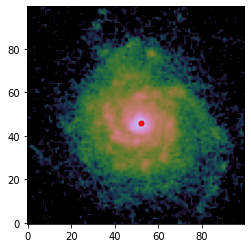

index: 137
center pixels: 50.0 46.0


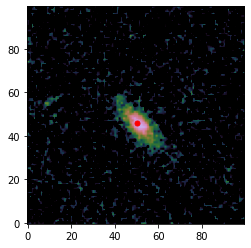

index: 456
center pixels: 51.0 47.0


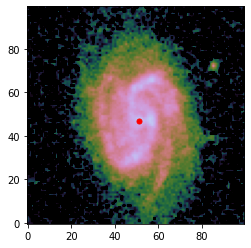

index: 325
center pixels: 53.00000000000001 46.0


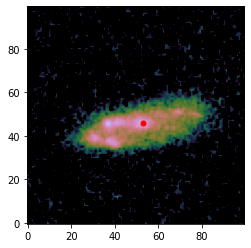

index: 779
center pixels: 46.0 42.0


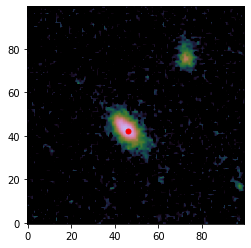

In [4]:
loaded_file = np.load('./hla_images_galaxyzoo_galaxies_notodd>0.85.npz')

images = loaded_file['images']
selected_galaxies = np.array([True if i in selected_galaxy_indices else False for i in range(len(images))])
good_iamge_indices = loaded_file['image_bool']

for i in np.random.choice(selected_galaxy_indices, size=5):
    print('index: {}'.format(i))
    noise_subtracted_image = subtract_background(images[i])
    noise_subtracted_image[noise_subtracted_image<=0] = 1e-1
    
    c_x, c_y = feature_encoder.get_offset_from_center(noise_subtracted_image, mask_radius=0.75)
    xc, yc = feature_encoder.arcsec2pix(c_x, c_y)
    print('center pixels:', xc, yc)
    
    plt.imshow(np.log10(noise_subtracted_image), origin='lower', 
               cmap='cubehelix', vmin=1, vmax=np.log10(noise_subtracted_image.max())+0.5)
    plt.plot(xc, yc, 'ro', markersize=5)
    plt.show()

## encode features

For each image:
- subtract noise
- extract shapelet coefficients as features

In [5]:
good_iamge_indices

array([0, 0, 1, ..., 1, 1, 1])

In [6]:
good_iamge_indices

array([0, 0, 1, ..., 1, 1, 1])

  0%|          | 0/796 [00:00<?, ?it/s]

/Users/ajshajib/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:30: RuntimeWarning: invalid value encountered in log10


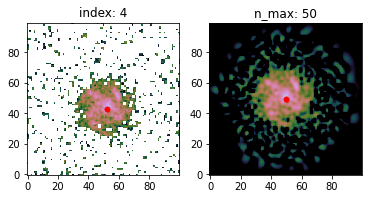

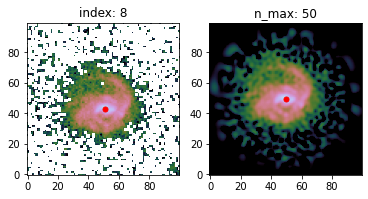

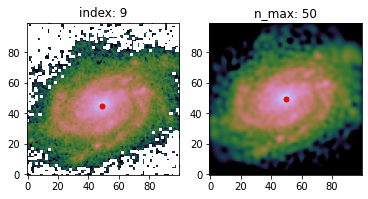

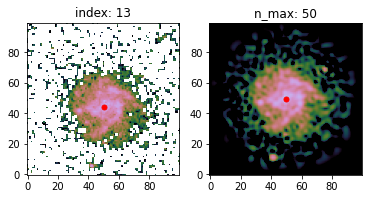

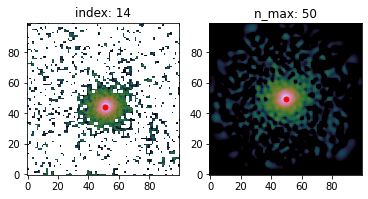

...

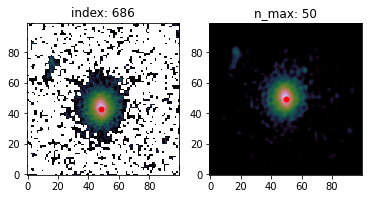

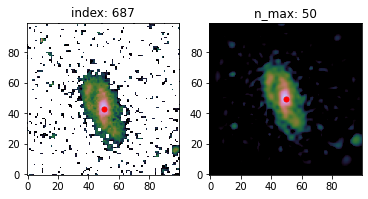

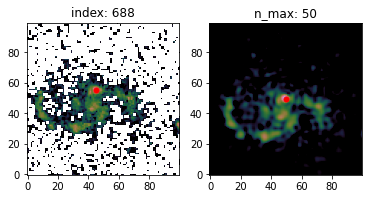

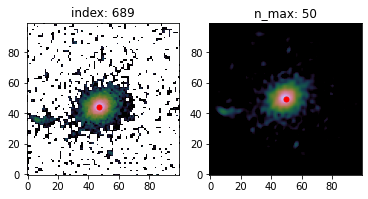

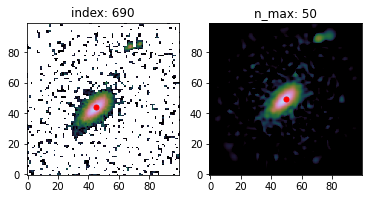

/Users/ajshajib/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:30: RuntimeWarning: divide by zero encountered in log10


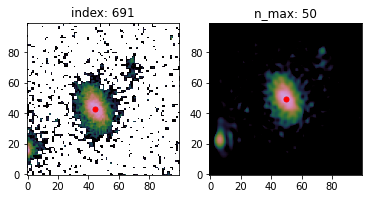

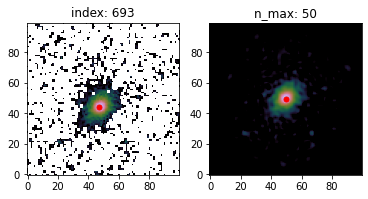

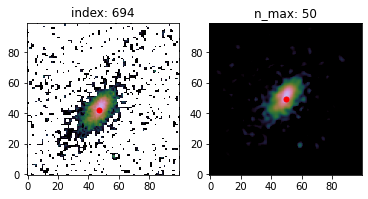

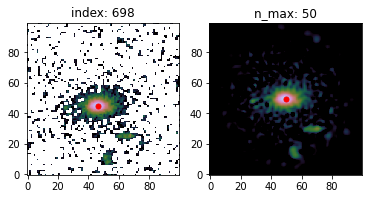

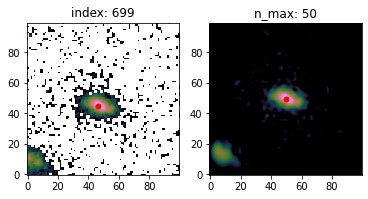

...

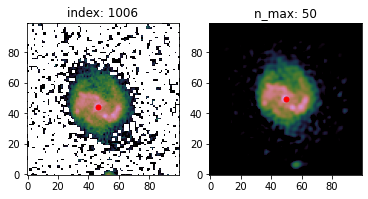

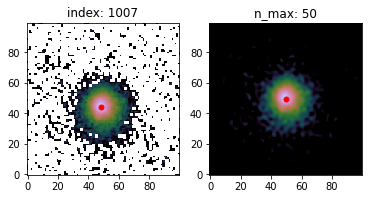

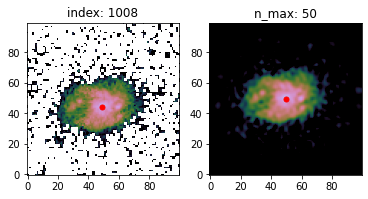

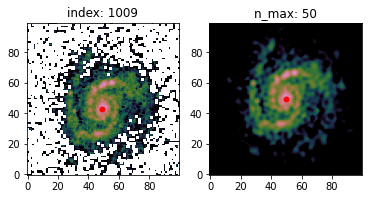

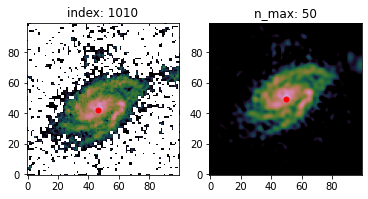

/Users/ajshajib/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app
/Users/ajshajib/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:40: RuntimeWarning: divide by zero encountered in log10


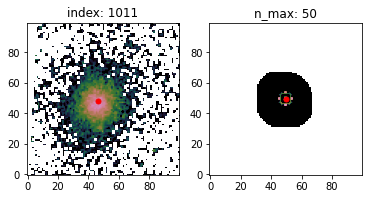

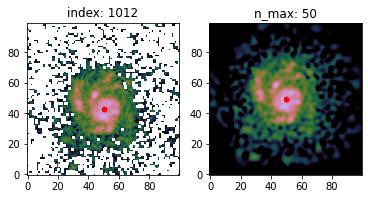

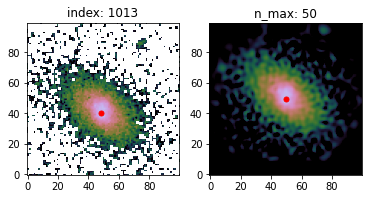

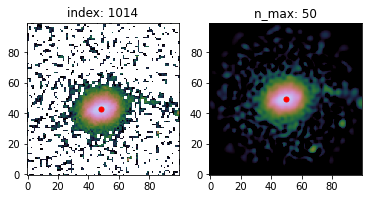

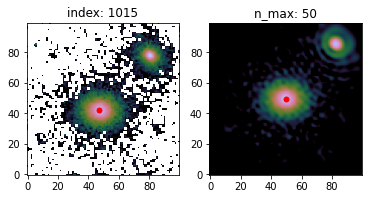

...

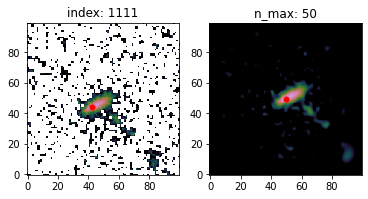

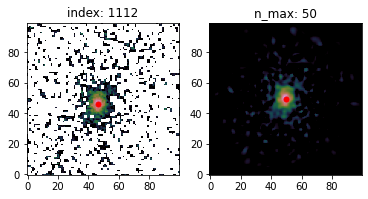

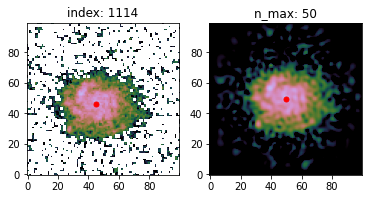

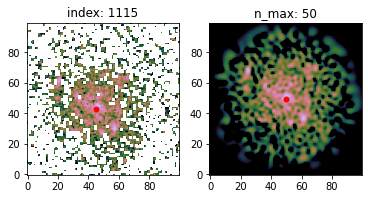

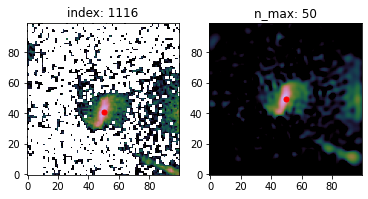

In [7]:
from tqdm.notebook import tqdm

feature_array = []
n_max = 50

is_debug = True

for index in tqdm(selected_galaxy_indices):
    image = images[index]

    if good_iamge_indices[index] == 1:
        noise_subtracted_image, background_rms = feature_encoder.subtract_background(image, 
                                                                                     with_background_rms=True)
        
        noise_map = np.sqrt(noise_subtracted_image + background_rms**2)
        
        offset = feature_encoder.get_offset_from_center(noise_subtracted_image)
        beta = feature_encoder.get_best_beta(noise_subtracted_image, noise_map, n_max, offset=offset)
        
        
        feature_array.append(
            feature_encoder.encode_image(noise_subtracted_image, noise_map, 
                                         n_max, beta=beta, rotate=0)
        )
            
        # plotting when debug mode is on
        if is_debug:
            fig, axes = plt.subplots(ncols=2)
            
            axes[0].imshow(np.log10(noise_subtracted_image), origin='lower', 
                   cmap='cubehelix', vmin=1, vmax=np.log10(noise_subtracted_image.max())+0.5)
            xc, yc = feature_encoder.arcsec2pix(offset[0], offset[1])
            axes[0].plot(xc, yc, 'ro', markersize=5)
            axes[0].set_title('index: {}'.format(index))
            
            decoded_image = feature_encoder.decode_image(feature_array[-1], n_max, beta=beta, offset=(0, 0))
            decoded_image[decoded_image < 0.] = 1e-1
            #print(feature_encoder.get_offset_from_center(decoded_image))
            
            axes[1].imshow(np.log10(decoded_image), origin='lower', 
                   cmap='cubehelix', vmin=1, vmax=np.log10(decoded_image.max())+0.5)
            axes[1].plot(49.5, 49.5, 'ro', markersize=5)
            axes[1].set_title('n_max: {}'.format(n_max))
            plt.show()  

In [8]:
drop = [  26,   36,   41,   67,   68,   70,   92,   97,  122,  128,  176,
        179,  214,  219,  228,  242,  249,  268,  310,  330,  334,  390,
        412,  422,  430,  436,  473,  487,  497,  505,  523,  524,  537,
        552,  566,  568,  572,  589,  591,  627,  654,  659,  673,  674,
        683,  688,  691,  695,  697,  699,  706,  716,  717,  730,  745,
        757,  766,  768,  770,  783,  786,  790,  794,  795,  796,  797,
        799,  800,  801,  802,  805,  811,  817,  818,  823,  826,  829,
        841,  842,  845,  846,  847,  849,  852,  853,  854,  857,  859,
        860,  861,  862,  869,  875,  880,  883,  885,  888,  894,  898,
        902,  907,  912,  913,  915,  916,  920,  925,  927,  928,  938,
        941,  945,  958,  961,  964,  969,  971,  976,  981,  982,  985,
        989,  985, 1011, 1015, 1017, 1021, 1026, 1035, 1041, 1044, 1052,
       1060, 1063, 1067, 1071, 1074, 1075, 1085, 1098, 1113, 1116]

In [9]:
new_feature_array = []

for s, f in zip(selected_galaxy_indices, feature_array):
    if s not in drop:
        new_feature_array.append(f)

In [10]:
len(new_feature_array)

697

In [11]:
np.savez_compressed('../source_galaxy_shapelet_coefficients_nmax50.npz', new_feature_array)